2025-01-26 11:28:45.325790: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-01-26 11:28:45.325927: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-01-26 11:28:45.451181: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Inputs shape: (1500, 256, 256, 1), Targets shape: (1500, 256, 256, 1)
Dataset created.
Epoch [1/100] - Gen_G Loss: 1.0279, Gen_F Loss: 1.0594, Disc_Font1 Loss: 0.0689, Disc_Font2 Loss: 0.0414


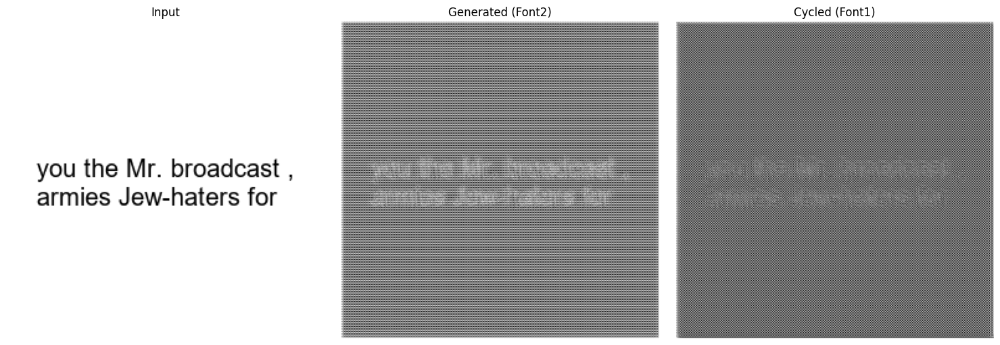

Epoch [2/100] - Gen_G Loss: 0.9864, Gen_F Loss: 0.9907, Disc_Font1 Loss: 0.0003, Disc_Font2 Loss: 0.0002


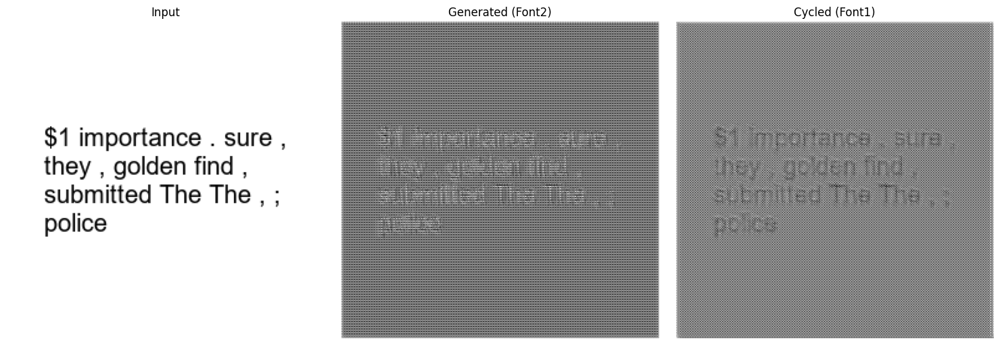

Epoch [3/100] - Gen_G Loss: 0.9837, Gen_F Loss: 0.9862, Disc_Font1 Loss: 0.0002, Disc_Font2 Loss: 0.0001


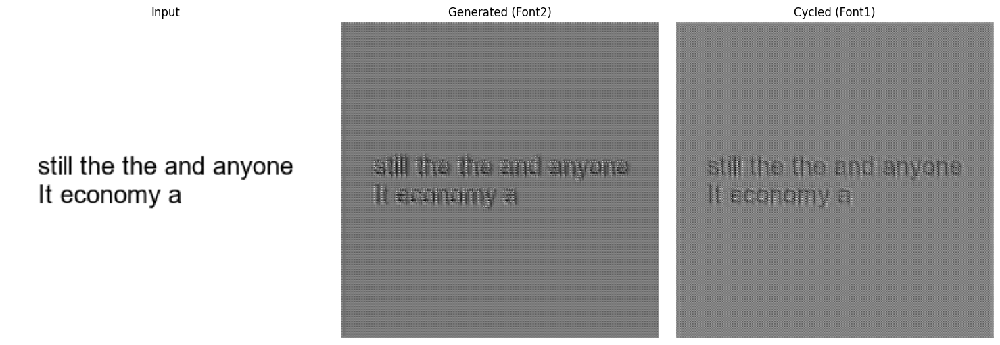

Epoch [4/100] - Gen_G Loss: 0.9786, Gen_F Loss: 0.9900, Disc_Font1 Loss: 0.0001, Disc_Font2 Loss: 0.0000


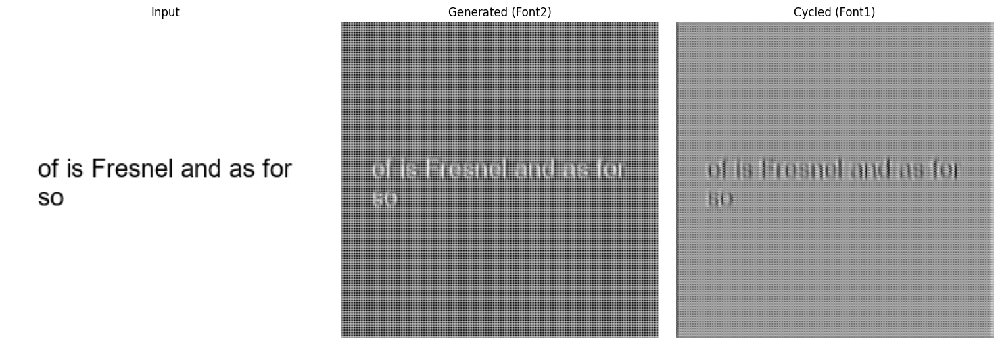

Epoch [5/100] - Gen_G Loss: 0.9702, Gen_F Loss: 0.9977, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


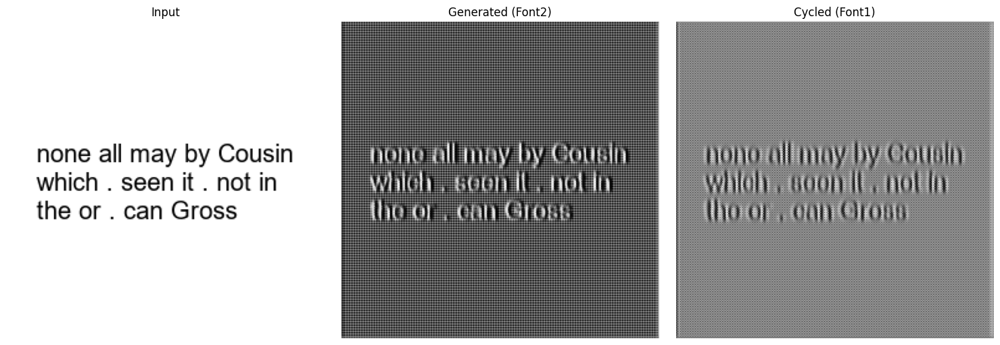

Epoch [6/100] - Gen_G Loss: 0.9625, Gen_F Loss: 0.9663, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


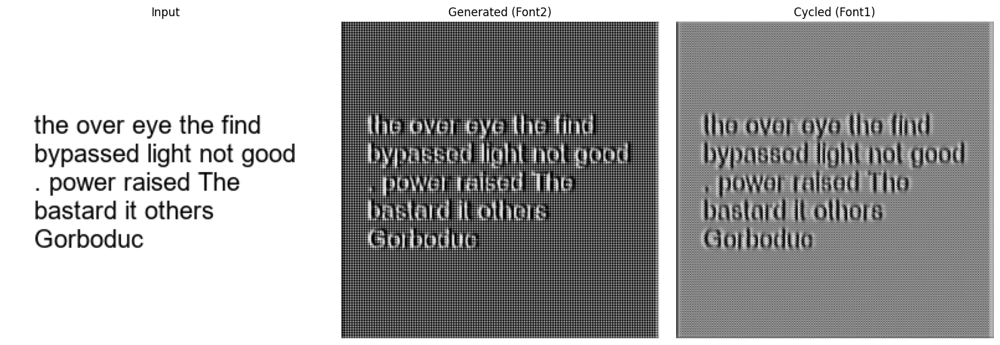

Epoch [7/100] - Gen_G Loss: 0.8558, Gen_F Loss: 0.9814, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


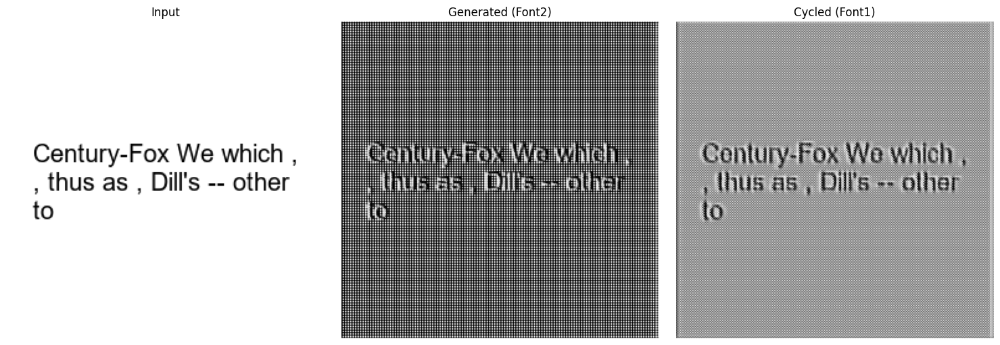

Epoch [8/100] - Gen_G Loss: 0.6232, Gen_F Loss: 0.9240, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


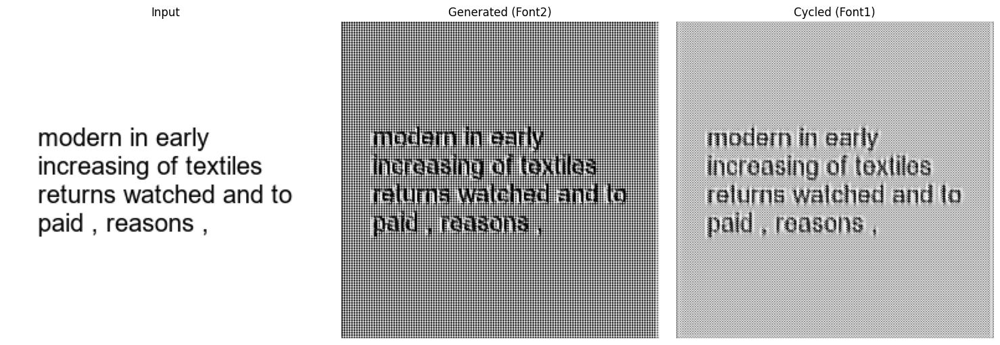

Epoch [9/100] - Gen_G Loss: 0.4907, Gen_F Loss: 0.8124, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


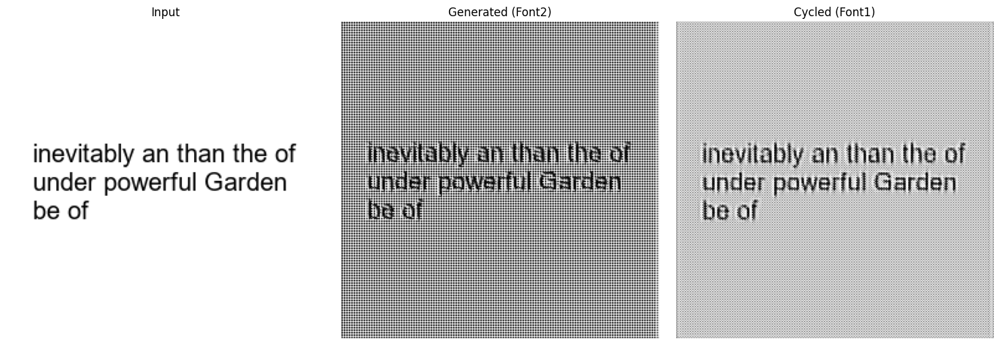

Epoch [10/100] - Gen_G Loss: 0.3335, Gen_F Loss: 0.6120, Disc_Font1 Loss: 0.0002, Disc_Font2 Loss: 0.0000


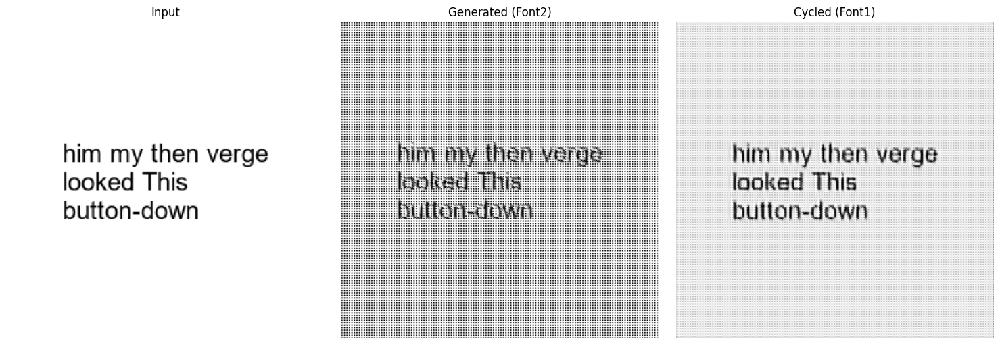

Epoch [11/100] - Gen_G Loss: 0.2937, Gen_F Loss: 0.4499, Disc_Font1 Loss: 0.0001, Disc_Font2 Loss: 0.0001


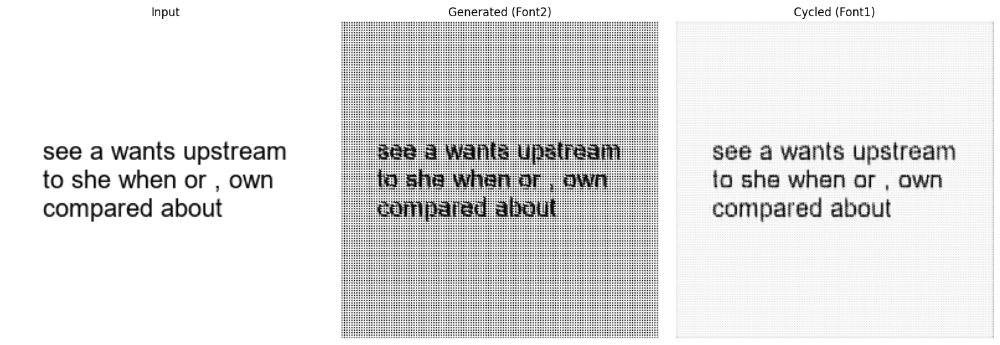

Epoch [12/100] - Gen_G Loss: 0.2508, Gen_F Loss: 0.4846, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


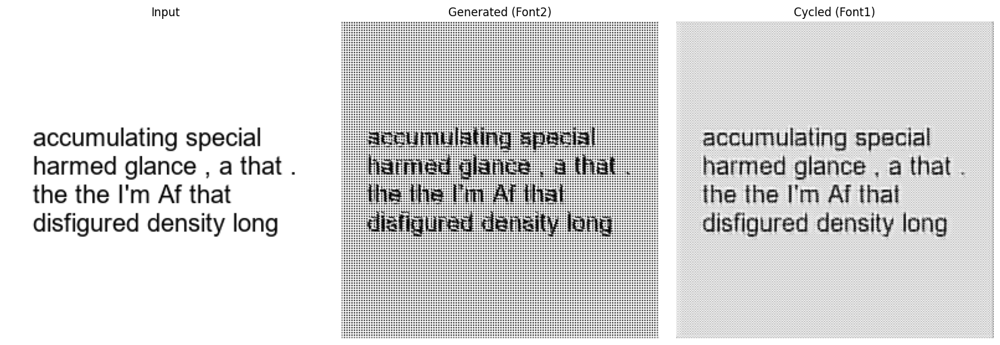

Epoch [13/100] - Gen_G Loss: 0.2505, Gen_F Loss: 0.4910, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


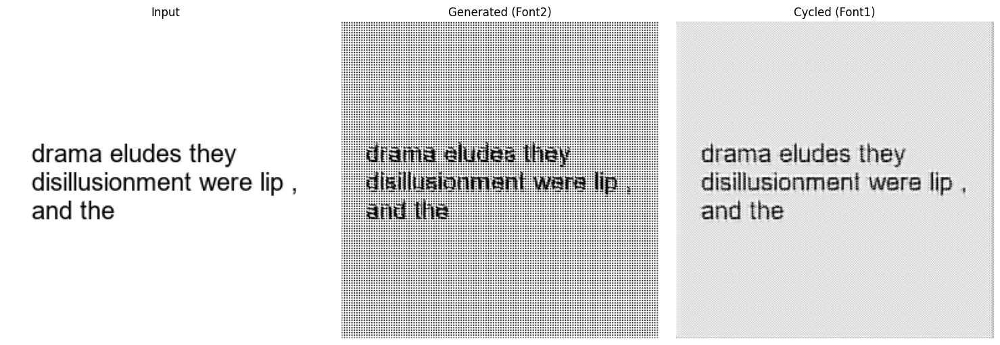

Epoch [14/100] - Gen_G Loss: 0.2704, Gen_F Loss: 0.4854, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


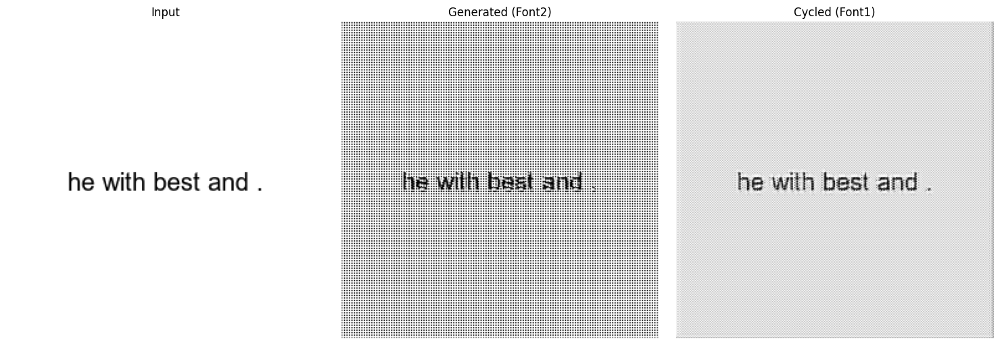

Epoch [15/100] - Gen_G Loss: 0.3057, Gen_F Loss: 0.4802, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


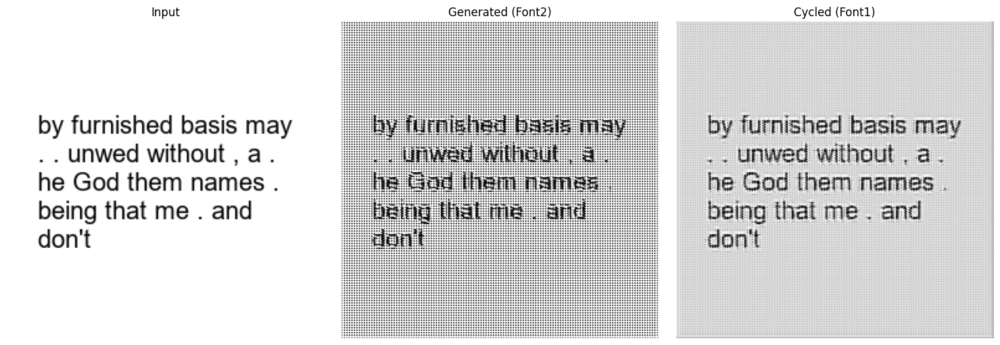

Epoch [16/100] - Gen_G Loss: 0.3462, Gen_F Loss: 0.4730, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


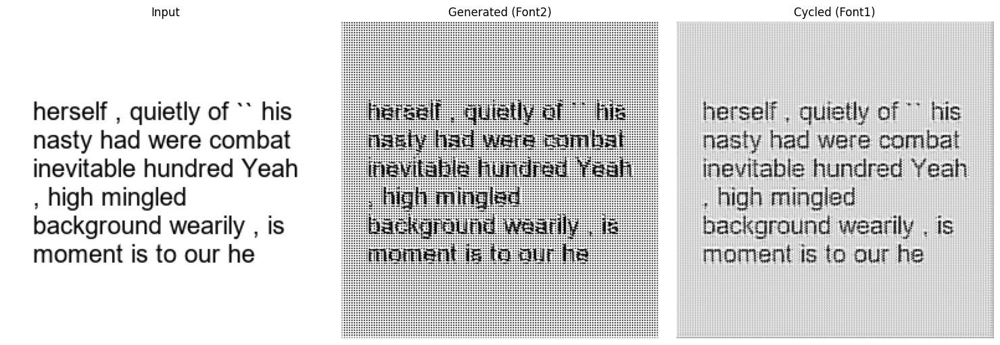

Epoch [17/100] - Gen_G Loss: 0.3177, Gen_F Loss: 0.4771, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


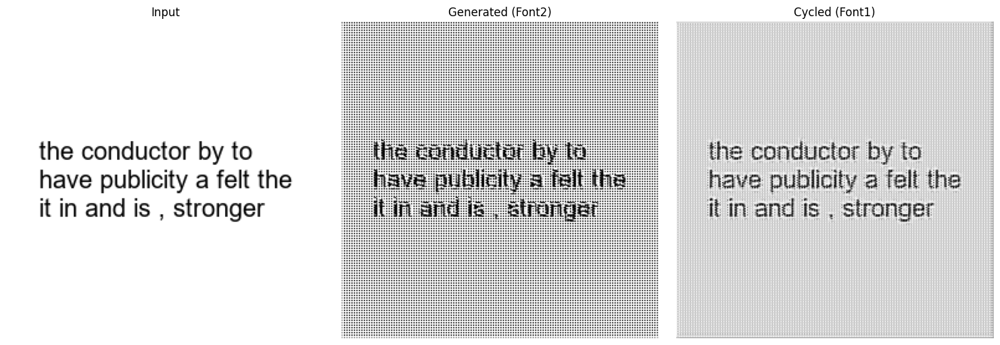

Epoch [18/100] - Gen_G Loss: 0.3306, Gen_F Loss: 0.4747, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


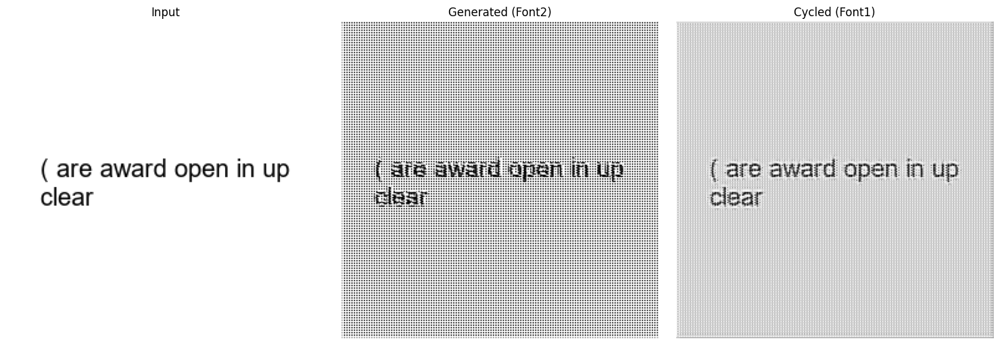

Epoch [19/100] - Gen_G Loss: 0.3484, Gen_F Loss: 0.4626, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


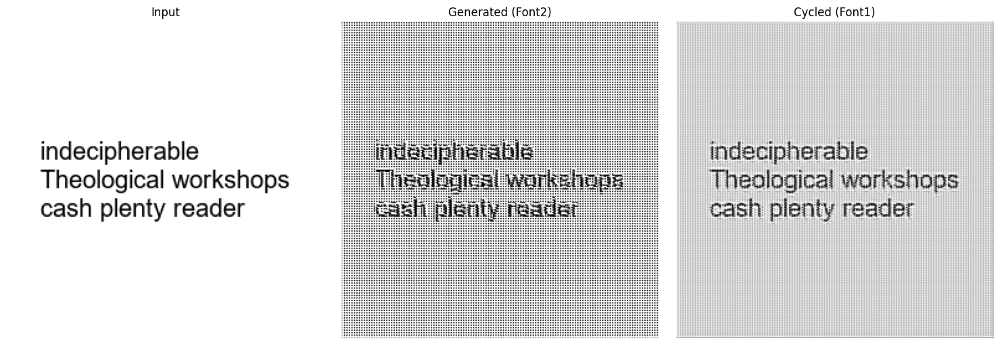

Epoch [20/100] - Gen_G Loss: 0.3622, Gen_F Loss: 0.4371, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


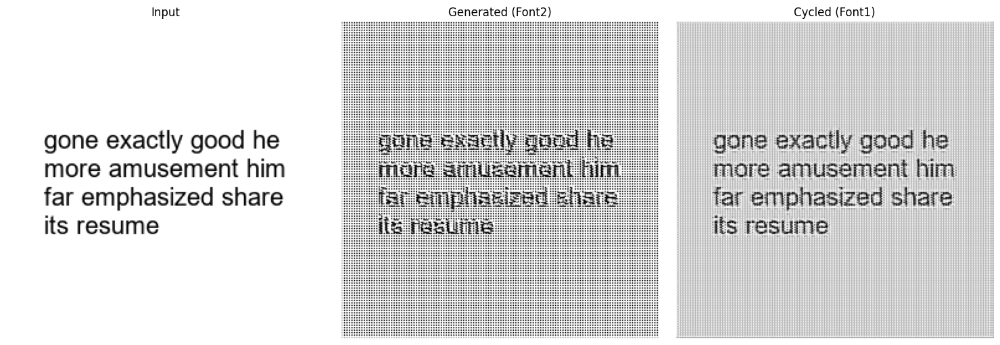

Epoch [21/100] - Gen_G Loss: 0.3737, Gen_F Loss: 0.3970, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


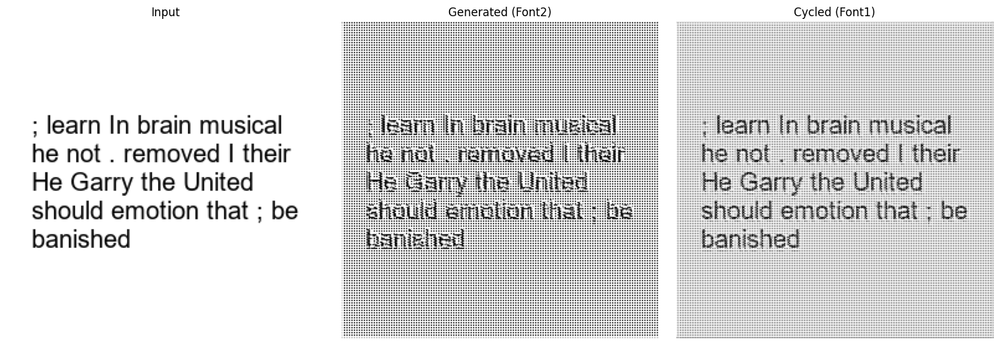

Epoch [22/100] - Gen_G Loss: 0.3359, Gen_F Loss: 0.3753, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


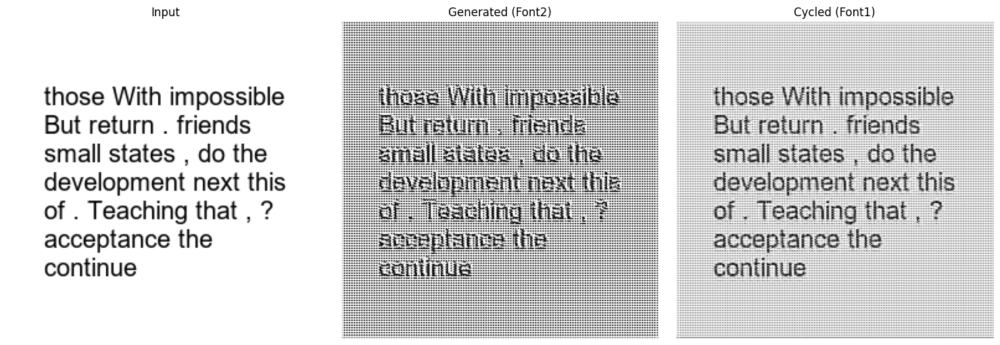

Epoch [23/100] - Gen_G Loss: 0.3343, Gen_F Loss: 0.3294, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


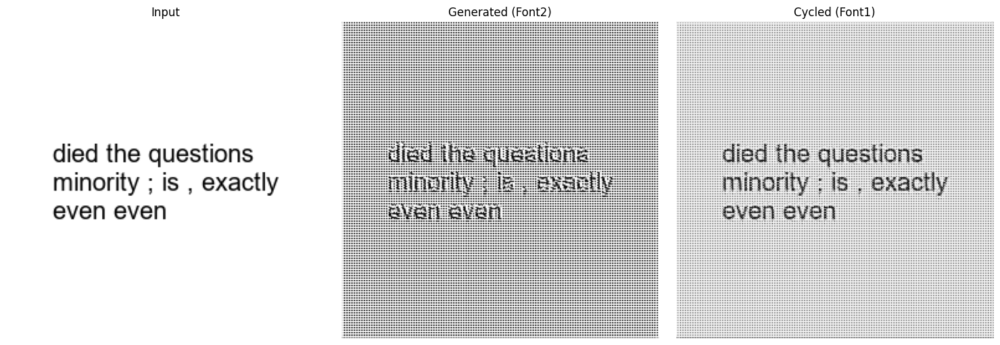

Epoch [24/100] - Gen_G Loss: 0.3379, Gen_F Loss: 0.2470, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


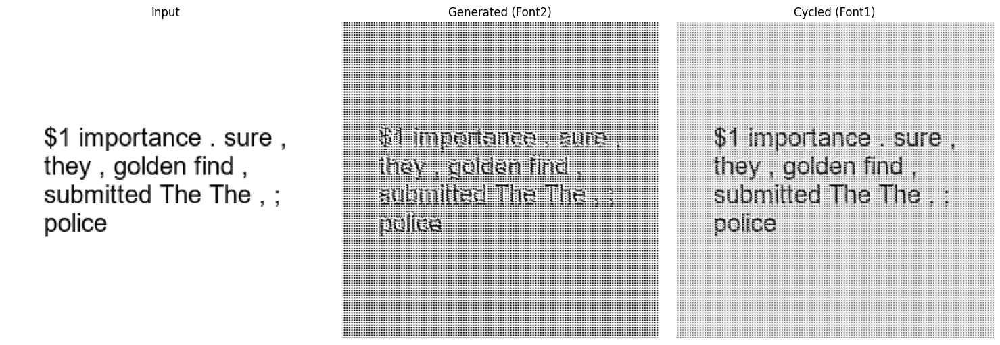

Epoch [25/100] - Gen_G Loss: 0.3281, Gen_F Loss: 0.1938, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


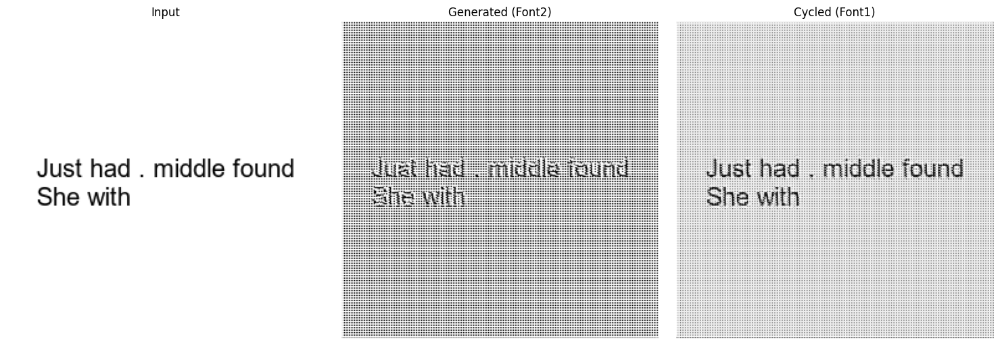

Epoch [26/100] - Gen_G Loss: 0.2516, Gen_F Loss: 0.1393, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


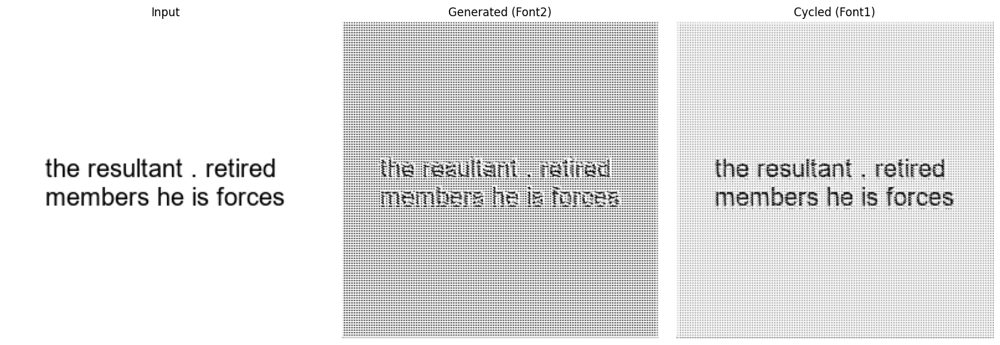

Epoch [27/100] - Gen_G Loss: 0.2383, Gen_F Loss: 0.1300, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


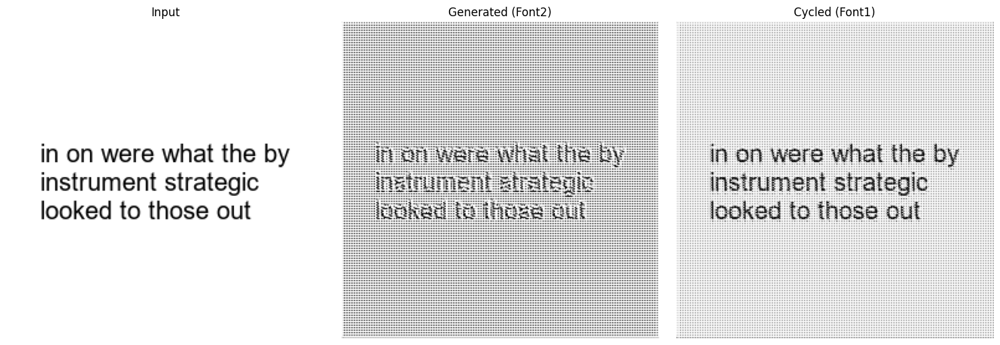

Epoch [28/100] - Gen_G Loss: 0.2371, Gen_F Loss: 0.1247, Disc_Font1 Loss: 0.0000, Disc_Font2 Loss: 0.0000


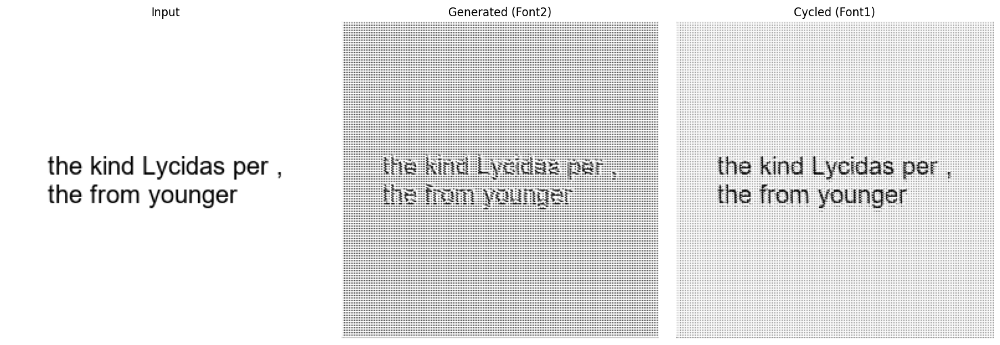

In [ ]:
import os
import numpy as np
from PIL import Image
import tensorflow as tf
from tensorflow.keras import layers, Model
import matplotlib.pyplot as plt

# Load and preprocess the data
def load_data(data_dir, img_size=(256, 256)):
    inputs = []
    targets = []
    for filename in os.listdir(data_dir):
        if "_input_" in filename:
            target_filename = filename.replace("_input_", "_target_")
            input_path = os.path.join(data_dir, filename)
            target_path = os.path.join(data_dir, target_filename)

            if not os.path.exists(target_path):
                print(f"Warning: Target file not found for {filename}. Skipping.")
                continue

            # Load, convert to grayscale (convert('L')), resize, and normalize
            input_img = Image.open(input_path).convert('L').resize(img_size) 
            target_img = Image.open(target_path).convert('L').resize(img_size)

            # Normalize to [-1, 1] and add channel dimension
            inputs.append(np.expand_dims(np.array(input_img) / 127.5 - 1, axis=-1))  # Ensure it's grayscale (1 channel)
            targets.append(np.expand_dims(np.array(target_img) / 127.5 - 1, axis=-1))  # Ensure it's grayscale (1 channel)

    return np.array(inputs, dtype=np.float32), np.array(targets, dtype=np.float32)

# Directory containing the data
data_dir = "/kaggle/input/calibritoarial/font_transfer_dataset/pairs"
inputs, targets = load_data(data_dir)
print(f"Inputs shape: {inputs.shape}, Targets shape: {targets.shape}")

batch_size = 10

# Create TensorFlow dataset
def create_tf_dataset(inputs, targets, batch_size):
    dataset = tf.data.Dataset.from_tensor_slices((inputs, targets))
    dataset = dataset.shuffle(buffer_size=len(inputs)).batch(batch_size).prefetch(tf.data.AUTOTUNE)
    return dataset

dataset = create_tf_dataset(inputs, targets, batch_size)
print("Dataset created.")

# Build generator model
def build_generator(input_shape=(256, 256, 1)):
    inputs = layers.Input(shape=input_shape)
    x = layers.Conv2D(64, (3, 3), strides=1, padding="same", activation="relu")(inputs)
    x = layers.Conv2D(128, (3, 3), strides=2, padding="same", activation="relu")(x)
    x = layers.Conv2DTranspose(64, (3, 3), strides=2, padding="same", activation="relu")(x) # In a transposed convolution, the input size is increased.
    outputs = layers.Conv2D(1, (3, 3), padding="same", activation="tanh")(x)  # Output with 1 channel (grayscale)
    return Model(inputs, outputs)

# Build discriminator model
def build_discriminator(input_shape=(256, 256, 1)):
    inputs = layers.Input(shape=input_shape)
    x = layers.Conv2D(64, (4, 4), strides=2, padding="same", activation="relu")(inputs)
    x = layers.Conv2D(128, (4, 4), strides=2, padding="same", activation="relu")(x)
    x = layers.Flatten()(x)
    outputs = layers.Dense(1, activation="sigmoid")(x)
    return Model(inputs, outputs)

# Create models
gen_g = build_generator()
gen_f = build_generator()
disc_font1 = build_discriminator()
disc_font2 = build_discriminator()

# Loss functions
# minimizeer l'err entre real and generated imgs
def adversarial_loss(real, generated):
    return tf.reduce_mean(tf.square(real - 1)) + tf.reduce_mean(tf.square(generated)) # delete tf.reduce_mean ?

def cycle_consistency_loss(real_image, cycled_image):
    return tf.reduce_mean(tf.abs(real_image - cycled_image))


# Optimizers
gen_g_optimizer = tf.keras.optimizers.Adam(2e-5, beta_1=0.5)
gen_f_optimizer = tf.keras.optimizers.Adam(2e-5, beta_1=0.5)
disc_font1_optimizer = tf.keras.optimizers.Adam(2e-5, beta_1=0.5)
disc_font2_optimizer = tf.keras.optimizers.Adam(2e-5, beta_1=0.5) # 2e-5 valeur initiale du taux d'apprentissage

# Training step
@tf.function
def train_step(real_font1, real_font2):
    with tf.GradientTape(persistent=True) as tape: # is used to track computations and automatically compute gradients of variables with respect to a loss or other outputs.
        # Font1 -> Font2 -> Font1
        fake_font2 = gen_g(real_font1, training=True)
        cycled_font1 = gen_f(fake_font2, training=True)

        # Font2 -> Font1 -> Font2
        fake_font1 = gen_f(real_font2, training=True)
        cycled_font2 = gen_g(fake_font1, training=True)

        # Discriminators
        disc_real_font1 = disc_font1(real_font1, training=True) # prediction [0,1]
        disc_fake_font1 = disc_font1(fake_font1, training=True)
        disc_real_font2 = disc_font2(real_font2, training=True)
        disc_fake_font2 = disc_font2(fake_font2, training=True)

        # Generator losses
        gen_g_loss = adversarial_loss(disc_real_font2, disc_fake_font2) + cycle_consistency_loss(real_font1, cycled_font1)
        gen_f_loss = adversarial_loss(disc_real_font1, disc_fake_font1) + cycle_consistency_loss(real_font2, cycled_font2)

        # Discriminator losses
        disc_font1_loss = adversarial_loss(disc_real_font1, disc_fake_font1)
        disc_font2_loss = adversarial_loss(disc_real_font2, disc_fake_font2)

    # Update gradients
    gen_g_gradients = tape.gradient(gen_g_loss, gen_g.trainable_variables) #Computes the gradient of the generator G's loss (gen_g_loss) with respect to its trainable variables (gen_g.trainable_variables
    gen_f_gradients = tape.gradient(gen_f_loss, gen_f.trainable_variables)
    disc_font1_gradients = tape.gradient(disc_font1_loss, disc_font1.trainable_variables)
    disc_font2_gradients = tape.gradient(disc_font2_loss, disc_font2.trainable_variables)

    gen_g_optimizer.apply_gradients(zip(gen_g_gradients, gen_g.trainable_variables)) # This updates the trainable variables (weights) of a model using the computed gradients.
                                  # zip(gradients, variables) pairs each gradient with its corresponding variable.
    gen_f_optimizer.apply_gradients(zip(gen_f_gradients, gen_f.trainable_variables))
    disc_font1_optimizer.apply_gradients(zip(disc_font1_gradients, disc_font1.trainable_variables))
    disc_font2_optimizer.apply_gradients(zip(disc_font2_gradients, disc_font2.trainable_variables))

    return gen_g_loss, gen_f_loss, disc_font1_loss, disc_font2_loss

# Function to visualize the input and generated images
def plot_results(input_image, generated_image, cycled_image, epoch, save_dir="results"):
    os.makedirs(save_dir, exist_ok=True)

    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    titles = ["Input", "Generated (Font2)", "Cycled (Font1)"]
    images = [input_image, generated_image, cycled_image]

    for ax, img, title in zip(axes, images, titles):
        ax.imshow(img.numpy().squeeze(), cmap="gray")
        ax.set_title(title)
        ax.axis("off")

    plt.tight_layout()
    plt.savefig(os.path.join(save_dir, f"epoch_{epoch + 1}.png"))
    plt.show()
    plt.close()

# Ensure you take the real Font2 image for proper visualization:
for epoch in range(90000):
    epoch_gen_g_loss = 0
    epoch_gen_f_loss = 0
    epoch_disc_font1_loss = 0
    epoch_disc_font2_loss = 0

    for real_font1, real_font2 in dataset:
        gen_g_loss, gen_f_loss, disc_font1_loss, disc_font2_loss = train_step(real_font1, real_font2)

        # Accumulate losses for average calculation
        epoch_gen_g_loss += gen_g_loss
        epoch_gen_f_loss += gen_f_loss
        epoch_disc_font1_loss += disc_font1_loss
        epoch_disc_font2_loss += disc_font2_loss

    print(f"Epoch [{epoch+1}/100] - "
          f"Gen_G Loss: {epoch_gen_g_loss.numpy()/len(dataset):.4f}, "
          f"Gen_F Loss: {epoch_gen_f_loss.numpy()/len(dataset):.4f}, "
          f"Disc_Font1 Loss: {epoch_disc_font1_loss.numpy()/len(dataset):.4f}, "
          f"Disc_Font2 Loss: {epoch_disc_font2_loss.numpy()/len(dataset):.4f}")

    # Visualization of results after each epoch
    sample_input = real_font1[0]  # Take one sample from the batch
    fake_font2 = gen_g(sample_input[None, ...], training=False)
    cycled_font1 = gen_f(fake_font2, training=False)

    # Visualizing both generated font images
    plot_results(sample_input, fake_font2, cycled_font1, epoch)


In [ ]:
disc_font1.save("disc_font1_model.h5")